In [1]:
import numpy as np
import scanpy as sc
import scvelo as scv
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import sys
import os
sys.path.append("..")

#### Load WT sample

In [2]:
dataset_name = 'GCB'
sample_name = 'CtcfWT29'
model_type = 'DynaVelo'
num_hidden = 200
zx_dim = 50
zy_dim = 50
k_z0 = 1000
k_t = 1000
k_velocity = 10000
k_consistency = 10000
seed = 0

model_suffix = f'{dataset_name}_{sample_name}_{model_type}_num_hidden_{num_hidden}_zxdim_{zx_dim}_zydim_{zy_dim}_k_z0_{str(k_z0)}_k_t_{str(k_t)}_k_velocity_{str(k_velocity)}_k_consistency_{str(k_consistency)}_seed_{seed}'

# load predicted RNA
adata_rna_pred = sc.read_h5ad(f"/media/labuser/STORAGE/sc-multiome/data/MelnickLab_GerminalCenter_BCells/processed_data_rna/predicted/RNA_Matrix_Pred_{model_suffix}.h5ad")

# load predicted ATAC
adata_atac_pred = sc.read_h5ad(f"/media/labuser/STORAGE/sc-multiome/data/MelnickLab_GerminalCenter_BCells/processed_data_atac/MotifMatrix/predicted/Motif_Matrix_Pred_{model_suffix}.h5ad")

# check if the cell names are the same
assert all(adata_rna_pred.obs_names == adata_atac_pred.obs_names)

OSError: Unable to open file (unable to open file: name = '/media/labuser/STORAGE/sc-multiome/data/MelnickLab_GerminalCenter_BCells/processed_data_rna/predicted/RNA_Matrix_Pred_GCB_CtcfWT29_DynaVelo_num_hidden_200_zxdim_50_zydim_50_k_z0_1000_k_t_1000_k_velocity_10000_k_consistency_10000_seed_0.h5ad', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [4]:
adata_atac_pred.obs['final.celltype'] = pd.Categorical(adata_atac_pred.obs['final.celltype'], categories=['Centroblast', 'Transitioning', 'Centrocyte', 'Plasmablast', 'Prememory'], ordered=True)
adata_atac_pred.obs['fine.celltype'] = pd.Categorical(adata_atac_pred.obs['fine.celltype'], categories=['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Transitioning_Sphase', 'CB_Rec_Sphase', 'CB_S_G2M', 'CB_G2M', 'Recycling', 'CC_Rec', 'Plasmablast', 'Prememory'], ordered=True)
adata_atac_pred.uns['final.celltype_colors'] = ['#74c476', '#9ecae1', '#3182bd', '#1be7ff', '#e2a0ff']
adata_atac_pred.uns['fine.celltype_colors'] = ['#deebf7', '#9ecae1', '#3182bd', '#edf8e9', '#bae4b3', '#74c476', '#238b45', '#d94701', '#fd8d3c', '#1be7ff', '#e2a0ff']

adata_rna_pred.obs['final.celltype'] = adata_atac_pred.obs['final.celltype']
adata_rna_pred.obs['fine.celltype'] = adata_atac_pred.obs['fine.celltype']
adata_rna_pred.uns['final.celltype_colors'] = adata_atac_pred.uns['final.celltype_colors']
adata_rna_pred.uns['fine.celltype_colors'] = adata_atac_pred.uns['fine.celltype_colors']

#### Load Arid1a Het. mutant sample

In [5]:
dataset_name = 'GCB'
sample_name = 'Arid1aHetM3'
model_type = 'DynaVelo'
num_hidden = 200
zx_dim = 50
zy_dim = 50
k_z0 = 1000
k_t = 1000
k_velocity = 10000
k_consistency = 10000
seed = 0

model_suffix = f'{dataset_name}_{sample_name}_{model_type}_num_hidden_{num_hidden}_zxdim_{zx_dim}_zydim_{zy_dim}_k_z0_{str(k_z0)}_k_t_{str(k_t)}_k_velocity_{str(k_velocity)}_k_consistency_{str(k_consistency)}_seed_{seed}'

# load predicted RNA
adata_rna_pred_Arid1aHet = sc.read_h5ad(f"/media/labuser/STORAGE/sc-multiome/data/MelnickLab_GerminalCenter_BCells/processed_data_rna/predicted/RNA_Matrix_Pred_{model_suffix}.h5ad")

# load predicted ATAC
adata_atac_pred_Arid1aHet = sc.read_h5ad(f"/media/labuser/STORAGE/sc-multiome/data/MelnickLab_GerminalCenter_BCells/processed_data_atac/MotifMatrix/predicted/Motif_Matrix_Pred_{model_suffix}.h5ad")

# check if the cell names are the same
assert all(adata_rna_pred_Arid1aHet.obs_names == adata_atac_pred_Arid1aHet.obs_names)

In [6]:
adata_atac_pred_Arid1aHet.obs['final.celltype'] = pd.Categorical(adata_atac_pred_Arid1aHet.obs['final.celltype'], categories=['Centroblast', 'Transitioning', 'Centrocyte', 'Plasmablast', 'Prememory'], ordered=True)
adata_atac_pred_Arid1aHet.obs['fine.celltype'] = pd.Categorical(adata_atac_pred_Arid1aHet.obs['fine.celltype'], categories=['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Transitioning_Sphase', 'CB_Rec_Sphase', 'CB_S_G2M', 'CB_G2M', 'Recycling', 'CC_Rec', 'Plasmablast', 'Prememory'], ordered=True)
adata_atac_pred_Arid1aHet.uns['final.celltype_colors'] = ['#74c476', '#9ecae1', '#3182bd', '#1be7ff', '#e2a0ff']
adata_atac_pred_Arid1aHet.uns['fine.celltype_colors'] = ['#deebf7', '#9ecae1', '#3182bd', '#edf8e9', '#bae4b3', '#74c476', '#238b45', '#d94701', '#fd8d3c', '#1be7ff', '#e2a0ff']

adata_rna_pred_Arid1aHet.obs['final.celltype'] = adata_atac_pred_Arid1aHet.obs['final.celltype']
adata_rna_pred_Arid1aHet.obs['fine.celltype'] = adata_atac_pred_Arid1aHet.obs['fine.celltype']
adata_rna_pred_Arid1aHet.uns['final.celltype_colors'] = adata_atac_pred_Arid1aHet.uns['final.celltype_colors']
adata_rna_pred_Arid1aHet.uns['fine.celltype_colors'] = adata_atac_pred_Arid1aHet.uns['fine.celltype_colors']

In [7]:
# check size of RNA and ATAC adata
print(adata_rna_pred_Arid1aHet.shape)
print(adata_atac_pred_Arid1aHet.shape)

(6716, 2433)
(6716, 157)


#### Load Ctcf Het. mutant sample

In [2]:
dataset_name = 'GCB'
sample_name = 'CtcfHet30'
model_type = 'DynaVelo'
num_hidden = 200
zx_dim = 50
zy_dim = 50
k_z0 = 1000
k_t = 1000
k_velocity = 10000
k_consistency = 10000
seed = 0

model_suffix = f'{dataset_name}_{sample_name}_{model_type}_num_hidden_{num_hidden}_zxdim_{zx_dim}_zydim_{zy_dim}_k_z0_{str(k_z0)}_k_t_{str(k_t)}_k_velocity_{str(k_velocity)}_k_consistency_{str(k_consistency)}_seed_{seed}'

# load predicted RNA
adata_rna_pred_CtcfHet = sc.read_h5ad(f"/media/labuser/STORAGE/sc-multiome/data/MelnickLab_GerminalCenter_BCells/processed_data_rna/predicted/RNA_Matrix_Pred_{model_suffix}.h5ad")

# load predicted ATAC
adata_atac_pred_CtcfHet = sc.read_h5ad(f"/media/labuser/STORAGE/sc-multiome/data/MelnickLab_GerminalCenter_BCells/processed_data_atac/MotifMatrix/predicted/Motif_Matrix_Pred_{model_suffix}.h5ad")

# check if the cell names are the same
assert all(adata_rna_pred_CtcfHet.obs_names == adata_atac_pred_CtcfHet.obs_names)

In [3]:
adata_atac_pred_CtcfHet.obs['final.celltype'] = pd.Categorical(adata_atac_pred_CtcfHet.obs['final.celltype'], categories=['Centroblast', 'Transitioning', 'Centrocyte', 'Plasmablast', 'Prememory'], ordered=True)
adata_atac_pred_CtcfHet.obs['fine.celltype'] = pd.Categorical(adata_atac_pred_CtcfHet.obs['fine.celltype'], categories=['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Transitioning_Sphase', 'CB_Rec_Sphase', 'CB_S_G2M', 'CB_G2M', 'Recycling', 'CC_Rec', 'Plasmablast', 'Prememory'], ordered=True)
adata_atac_pred_CtcfHet.uns['final.celltype_colors'] = ['#74c476', '#9ecae1', '#3182bd', '#1be7ff', '#e2a0ff']
adata_atac_pred_CtcfHet.uns['fine.celltype_colors'] = ['#deebf7', '#9ecae1', '#3182bd', '#edf8e9', '#bae4b3', '#74c476', '#238b45', '#d94701', '#fd8d3c', '#1be7ff', '#e2a0ff']

adata_rna_pred_CtcfHet.obs['final.celltype'] = adata_atac_pred_CtcfHet.obs['final.celltype']
adata_rna_pred_CtcfHet.obs['fine.celltype'] = adata_atac_pred_CtcfHet.obs['fine.celltype']
adata_rna_pred_CtcfHet.uns['final.celltype_colors'] = adata_atac_pred_CtcfHet.uns['final.celltype_colors']
adata_rna_pred_CtcfHet.uns['fine.celltype_colors'] = adata_atac_pred_CtcfHet.uns['fine.celltype_colors']

In [4]:
# check size of RNA and ATAC adata
print(adata_rna_pred_CtcfHet.shape)
print(adata_atac_pred_CtcfHet.shape)

(4688, 2739)
(4688, 172)


#### Fig 4A

computing velocity graph (using 1/24 cores)


  0%|          | 0/6716 [00:00<?, ?cells/s]

    finished (0:00:14) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ../figures/Fig4/vx_pred_x_obs_stream_velocity_genes_GCB_Arid1aHetM3_DynaVelo_num_hidden_200_zxdim_50_zydim_50_k_z0_1000_k_t_1000_k_velocity_10000_k_consistency_10000_seed_0.pdf


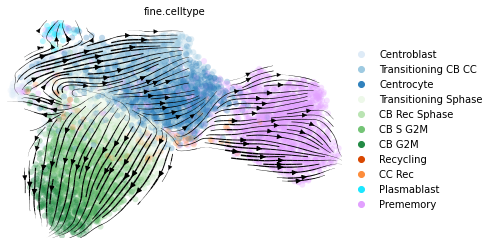

In [4]:
fig_dir = f'../figures/Fig4'
if not os.path.exists(fig_dir):
    os.makedirs(fig_dir)

adata_rna_pred_Arid1aHet.layers['velocity'] = adata_rna_pred_Arid1aHet.layers['vx_pred_mean'].copy()
velocity_genes = adata_rna_pred_Arid1aHet.var['velocity_genes'][adata_rna_pred_Arid1aHet.var['velocity_genes']].index.values
scv.tl.velocity_graph(adata_rna_pred_Arid1aHet, xkey='X', vkey='velocity', gene_subset=velocity_genes, sqrt_transform=False)
scv.pl.velocity_embedding_stream(adata_rna_pred_Arid1aHet, color=['fine.celltype'], basis='umap', legend_loc='right margin', save=fig_dir+f'/vx_pred_x_obs_stream_velocity_genes_Arid1aHet.pdf')

computing velocity graph (using 1/24 cores)


  0%|          | 0/6716 [00:00<?, ?cells/s]

    finished (0:00:59) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
figure cannot be saved as pdf, using png instead.
saving figure to file ../figures/Fig4/vx_pred_x_obs_stream_all_genes_GCB_Arid1aHetM3_DynaVelo_num_hidden_200_zxdim_50_zydim_50_k_z0_1000_k_t_1000_k_velocity_10000_k_consistency_10000_seed_0.png


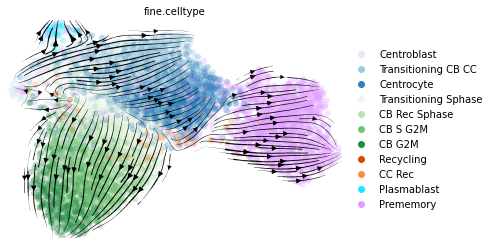

In [5]:
scv.tl.velocity_graph(adata_rna_pred_Arid1aHet, xkey='X', vkey='velocity', gene_subset=adata_rna_pred_Arid1aHet.var_names, sqrt_transform=False)
scv.pl.velocity_embedding_stream(adata_rna_pred_Arid1aHet, color=['fine.celltype'], basis='umap', legend_loc='right margin', save=fig_dir+f'/vx_pred_x_obs_stream_all_genes_Arid1aHet.pdf')

computing velocity graph (using 1/24 cores)


  0%|          | 0/6716 [00:00<?, ?cells/s]

    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
figure cannot be saved as pdf, using png instead.
saving figure to file ../figures/Fig4/vy_pred_y_obs_stream_GCB_Arid1aHetM3_DynaVelo_num_hidden_200_zxdim_50_zydim_50_k_z0_1000_k_t_1000_k_velocity_10000_k_consistency_10000_seed_0.png


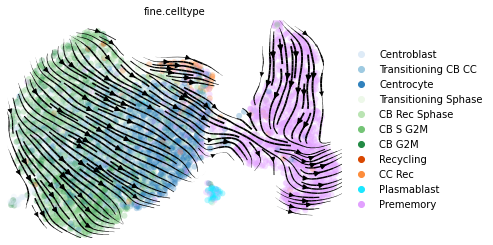

In [6]:
sc.pp.neighbors(adata_atac_pred_Arid1aHet, n_neighbors=50, use_rep='X')
sc.tl.umap(adata_atac_pred_Arid1aHet, min_dist=1, spread=1, random_state=0, n_components=2)
adata_atac_pred_Arid1aHet.layers['velocity'] = adata_atac_pred_Arid1aHet.layers['vy_pred_mean'].copy()
adata_atac_pred_Arid1aHet.layers['state'] = adata_atac_pred_Arid1aHet.X.copy()

scv.tl.velocity_graph(adata_atac_pred_Arid1aHet, xkey='state', vkey='velocity', gene_subset=adata_atac_pred_Arid1aHet.var_names, sqrt_transform=False)
scv.pl.velocity_embedding_stream(adata_atac_pred_Arid1aHet, color=['fine.celltype'], basis='umap', legend_loc='right margin', save=fig_dir+f'/vy_pred_y_obs_stream_Arid1aHet.pdf')

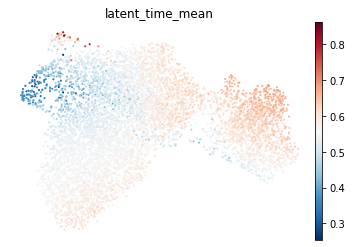

In [7]:
sc.pl.umap(adata_rna_pred_Arid1aHet, color=['latent_time_mean'], color_map='RdBu_r', show=False, frameon=False)
plt.savefig(fig_dir+f'/umap_RNA_latent_time_mean_Arid1aHet.pdf', bbox_inches="tight")

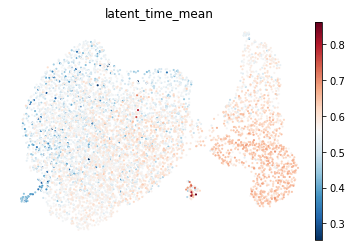

In [8]:
sc.pl.umap(adata_atac_pred_Arid1aHet, color=['latent_time_mean'], color_map='RdBu_r', show=False, frameon=False)
plt.savefig(fig_dir+f'/umap_motif_latent_time_mean_Arid1aHet.pdf', bbox_inches="tight")

#### Fig. 4B

computing velocity graph (using 1/24 cores)


  0%|          | 0/4688 [00:00<?, ?cells/s]

    finished (0:00:13) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ../figures/Fig4/vx_pred_x_obs_stream_velocity_genes_CtcfHet.pdf


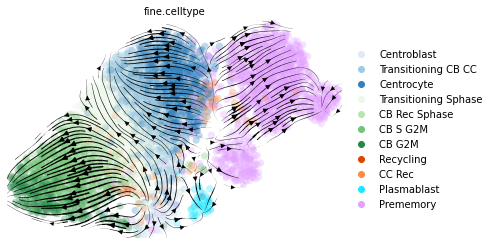

In [11]:
adata_rna_pred_CtcfHet.layers['velocity'] = adata_rna_pred_CtcfHet.layers['vx_pred_mean'].copy()
velocity_genes = adata_rna_pred_CtcfHet.var['velocity_genes'][adata_rna_pred_CtcfHet.var['velocity_genes']].index.values
scv.tl.velocity_graph(adata_rna_pred_CtcfHet, xkey='X', vkey='velocity', gene_subset=velocity_genes, sqrt_transform=False)
scv.pl.velocity_embedding_stream(adata_rna_pred_CtcfHet, color=['fine.celltype'], basis='umap', legend_loc='right margin', save=fig_dir+f'/vx_pred_x_obs_stream_velocity_genes_CtcfHet.pdf')

computing velocity graph (using 1/24 cores)


  0%|          | 0/4688 [00:00<?, ?cells/s]

    finished (0:00:48) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
figure cannot be saved as pdf, using png instead.
saving figure to file ../figures/Fig4/vx_pred_x_obs_stream_all_genes_CtcfHet.png


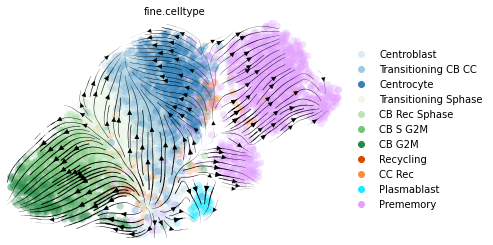

In [12]:
scv.tl.velocity_graph(adata_rna_pred_CtcfHet, xkey='X', vkey='velocity', gene_subset=adata_rna_pred_CtcfHet.var_names, sqrt_transform=False)
scv.pl.velocity_embedding_stream(adata_rna_pred_CtcfHet, color=['fine.celltype'], basis='umap', legend_loc='right margin', save=fig_dir+f'/vx_pred_x_obs_stream_all_genes_CtcfHet.pdf')

computing velocity graph (using 1/24 cores)


  0%|          | 0/4688 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ../figures/Fig4/vy_pred_y_obs_stream_CtcfHet.pdf


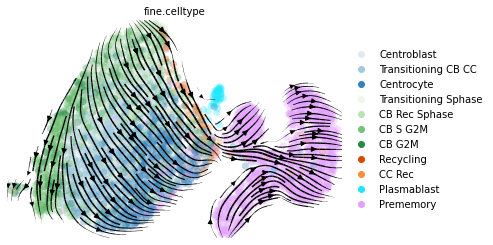

In [13]:
sc.pp.neighbors(adata_atac_pred_CtcfHet, n_neighbors=50, use_rep='X')
sc.tl.umap(adata_atac_pred_CtcfHet, min_dist=1, spread=1, random_state=0, n_components=2)
adata_atac_pred_CtcfHet.layers['velocity'] = adata_atac_pred_CtcfHet.layers['vy_pred_mean'].copy()
adata_atac_pred_CtcfHet.layers['state'] = adata_atac_pred_CtcfHet.X.copy()

scv.tl.velocity_graph(adata_atac_pred_CtcfHet, xkey='state', vkey='velocity', gene_subset=adata_atac_pred_CtcfHet.var_names, sqrt_transform=False)
scv.pl.velocity_embedding_stream(adata_atac_pred_CtcfHet, color=['fine.celltype'], basis='umap', legend_loc='right margin', save=fig_dir+f'/vy_pred_y_obs_stream_CtcfHet.pdf')

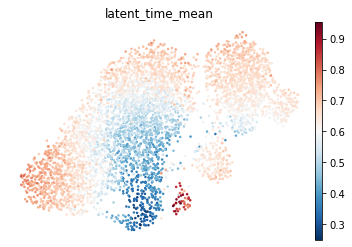

In [14]:
sc.pl.umap(adata_rna_pred_CtcfHet, color=['latent_time_mean'], color_map='RdBu_r', show=False, frameon=False)
plt.savefig(fig_dir+f'/umap_RNA_latent_time_mean_CtcfHet.pdf', bbox_inches="tight")

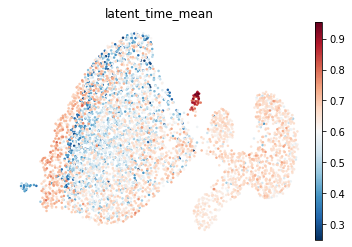

In [15]:
sc.pl.umap(adata_atac_pred_CtcfHet, color=['latent_time_mean'], color_map='RdBu_r', show=False, frameon=False)
plt.savefig(fig_dir+f'/umap_motif_latent_time_mean_CtcfHet.pdf', bbox_inches="tight")

#### Fig. 4C

In [19]:
TFs = np.intersect1d(adata_atac_pred.var_names, adata_atac_pred_CtcfHet.var_names)
TFs = np.intersect1d(TFs, adata_atac_pred_Arid1aHet.var_names)

adata_rna_pred_TF = adata_rna_pred[:, TFs]
adata_rna_pred_CtcfHet_TF = adata_rna_pred_CtcfHet[:, TFs]
adata_rna_pred_Arid1aHet_TF = adata_rna_pred_Arid1aHet[:, TFs]

# CtcfWT29
adata_rna_pred_CtcfWT29_CB = adata_rna_pred_TF[adata_rna_pred_TF.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_Sphase', 'CB_Rec_Sphase', 'CB_S_G2M', 'CB_G2M', 'Recycling'])]
adata_atac_pred_CB = adata_atac_pred[adata_atac_pred.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_Sphase', 'CB_Rec_Sphase', 'CB_S_G2M', 'CB_G2M', 'Recycling'])]

adata_rna_pred_CtcfWT29_PM = adata_rna_pred_TF[adata_rna_pred_TF.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Prememory', 'CC_Rec'])]
adata_atac_pred_PM = adata_atac_pred[adata_atac_pred.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Prememory', 'CC_Rec'])]

adata_rna_pred_CtcfWT29_PB = adata_rna_pred_TF[adata_rna_pred_TF.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Plasmablast', 'CC_Rec'])]
adata_atac_pred_PB = adata_atac_pred[adata_atac_pred.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Plasmablast', 'CC_Rec'])]

# CtcfHet
adata_rna_pred_CtcfHet_CB = adata_rna_pred_CtcfHet_TF[adata_rna_pred_CtcfHet_TF.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_Sphase', 'CB_Rec_Sphase', 'CB_S_G2M', 'CB_G2M', 'Recycling'])]
adata_atac_pred_CtcfHet_CB = adata_atac_pred_CtcfHet[adata_atac_pred_CtcfHet.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_Sphase', 'CB_Rec_Sphase', 'CB_S_G2M', 'CB_G2M', 'Recycling'])]

adata_rna_pred_CtcfHet_PM = adata_rna_pred_CtcfHet_TF[adata_rna_pred_CtcfHet_TF.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Prememory', 'CC_Rec'])]
adata_atac_pred_CtcfHet_PM = adata_atac_pred_CtcfHet[adata_atac_pred_CtcfHet.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Prememory', 'CC_Rec'])]

adata_rna_pred_CtcfHet_PB = adata_rna_pred_CtcfHet_TF[adata_rna_pred_CtcfHet_TF.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Plasmablast', 'CC_Rec'])]
adata_atac_pred_CtcfHet_PB = adata_atac_pred_CtcfHet[adata_atac_pred_CtcfHet.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Plasmablast', 'CC_Rec'])]

# Arid1aHet
adata_rna_pred_Arid1aHet_CB = adata_rna_pred_Arid1aHet_TF[adata_rna_pred_Arid1aHet_TF.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_Sphase', 'CB_Rec_Sphase', 'CB_S_G2M', 'CB_G2M', 'Recycling'])]
adata_atac_pred_Arid1aHet_CB = adata_atac_pred_Arid1aHet[adata_atac_pred_Arid1aHet.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_Sphase', 'CB_Rec_Sphase', 'CB_S_G2M', 'CB_G2M', 'Recycling'])]

adata_rna_pred_Arid1aHet_PM = adata_rna_pred_Arid1aHet_TF[adata_rna_pred_Arid1aHet_TF.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Prememory', 'CC_Rec'])]
adata_atac_pred_Arid1aHet_PM = adata_atac_pred_Arid1aHet[adata_atac_pred_Arid1aHet.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Prememory', 'CC_Rec'])]

adata_rna_pred_Arid1aHet_PB = adata_rna_pred_Arid1aHet_TF[adata_rna_pred_Arid1aHet_TF.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Plasmablast', 'CC_Rec'])]
adata_atac_pred_Arid1aHet_PB = adata_atac_pred_Arid1aHet[adata_atac_pred_Arid1aHet.obs['fine.celltype'].isin(['Centroblast', 'Transitioning_CB_CC', 'Centrocyte', 'Plasmablast', 'CC_Rec'])]

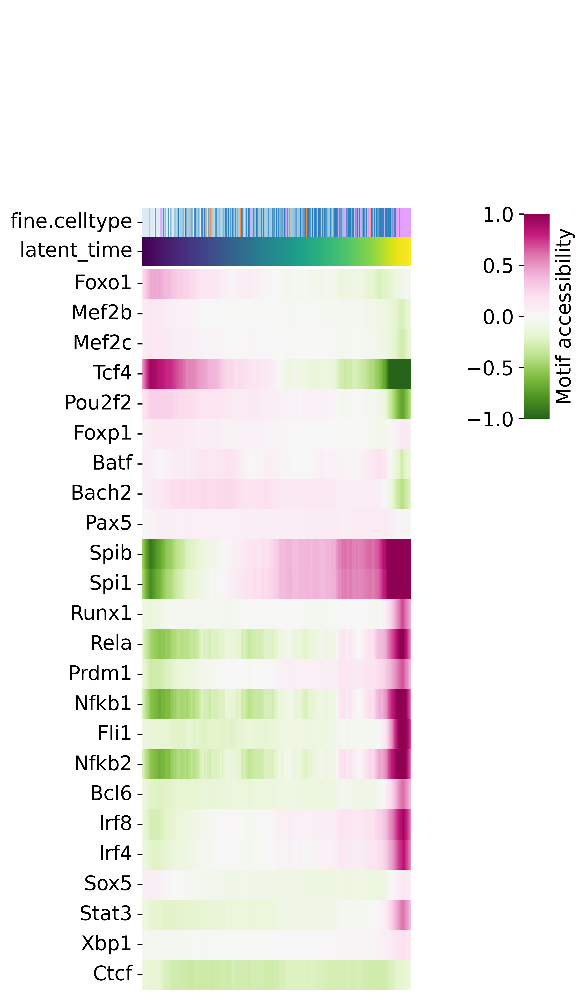

In [20]:

sc.set_figure_params(vector_friendly=True, dpi_save=300, dpi=300)

tfs_to_plot = ['ARID1A', 'CTCF', 'POU2AF1', 'POU2F2', 'BCL6', 'IRF8', 'FOXO1', 'FOXP1', 'SPI1', 'SPIB', 'CREBBP', 'PRDM1', 'BATF', 'BCOR', 'TOX', 'PAX5', 'BACH2', 'MEF2B', 'MEF2C', 'NFKB1', 'NFKB2', 'STAT3', 'NOTCH2', 'RELA', 'NSD2', 'HHEX', 'XBP1', 'IRF4', 'MYC', 'TCF4', 'Fli1', 'Runx1', 'SOX5']
tfs_to_plot = [g.capitalize() for g in tfs_to_plot]
tfs_to_plot = list(np.intersect1d(TFs, tfs_to_plot))

data = adata_atac_pred_PM[:, tfs_to_plot].to_df()
annotations = adata_atac_pred_PM.obs[['fine.celltype', 'latent_time']]
annotations['fine.celltype_str'] = annotations['fine.celltype'].astype(str)

celltype_palette = sns.color_palette(adata_atac_pred_PM.uns['fine.celltype_colors'])
celltype_dict = dict(zip(adata_atac_pred_PM.obs['fine.celltype'].cat.categories, celltype_palette))
celltype_colors = annotations['fine.celltype_str'].map(celltype_dict)

norm = mcolors.Normalize(vmin=annotations['latent_time'].min(), vmax=annotations['latent_time'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
latent_time_colors = annotations['latent_time'].map(lambda x: mcolors.to_hex(sm.to_rgba(x)))

row_colors = pd.DataFrame({
    'fine.celltype': celltype_colors,
    'latent_time': latent_time_colors
})

annotations_sorted = annotations.sort_values(by=['latent_time'])
data_sorted = data.loc[annotations_sorted.index].transpose()

smooth = True
N_smooth = 200
if smooth:
    data_smooth = data_sorted.values.copy()
    for r in range(data_smooth.shape[0]):
        data_smooth[r] = np.convolve(data_smooth[r], np.ones(N_smooth)/N_smooth, mode='same')
    data_sorted.loc[:] = data_smooth

idx = np.argsort(data_sorted.values.argmax(1))
data_sorted = data_sorted.iloc[idx]
tfs_to_plot = data_sorted.index

g = sns.clustermap(
    data_sorted,
    row_cluster=False,
    col_cluster=False,
    col_colors=row_colors,
    cmap='PiYG_r',
    xticklabels=False,
    center=0,
    vmax=1,
    vmin=-1,
    cbar_pos=(0.92, 0.58, 0.05, 0.2),
    figsize=(5, 10),
    rasterized=True
)
g.cax.set_ylabel('Motif accessibility')
g.tick_params(left=True, labelleft=True, right=False, labelright=False, labelrotation=0)
plt.savefig(fig_dir + f'/motif_accessibility_heatmap_sub_CtcfWT29_PM.pdf', bbox_inches="tight")

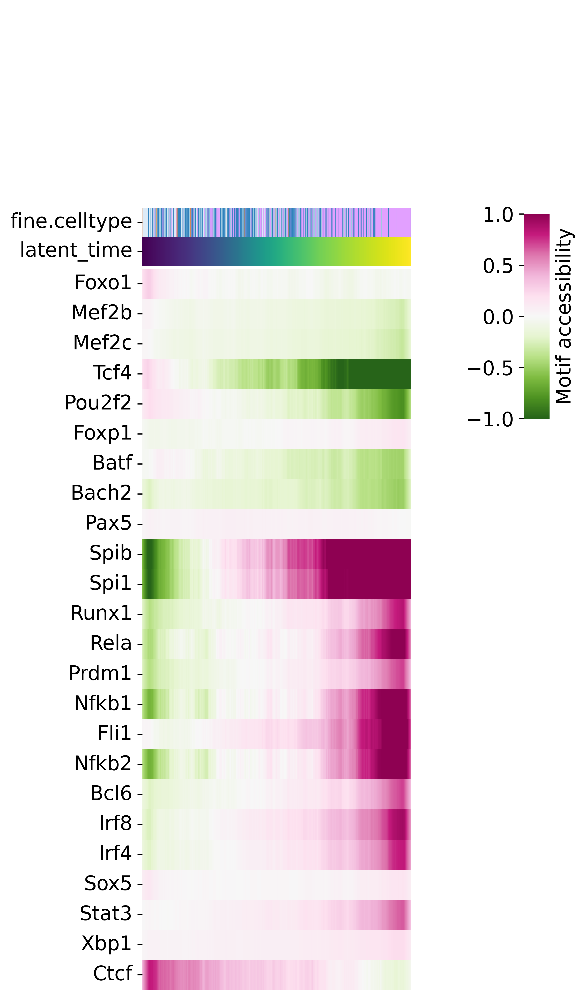

In [21]:
data = adata_atac_pred_Arid1aHet_PM[:, tfs_to_plot].to_df()
annotations = adata_atac_pred_Arid1aHet_PM.obs[['fine.celltype', 'latent_time']]
annotations['fine.celltype_str'] = annotations['fine.celltype'].astype(str)

celltype_palette = sns.color_palette(adata_atac_pred_Arid1aHet_PM.uns['fine.celltype_colors'])
celltype_dict = dict(zip(adata_atac_pred_Arid1aHet_PM.obs['fine.celltype'].cat.categories, celltype_palette))
celltype_colors = annotations['fine.celltype_str'].map(celltype_dict)

norm = mcolors.Normalize(vmin=annotations['latent_time'].min(), vmax=annotations['latent_time'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
latent_time_colors = annotations['latent_time'].map(lambda x: mcolors.to_hex(sm.to_rgba(x)))

row_colors = pd.DataFrame({
    'fine.celltype': celltype_colors,
    'latent_time': latent_time_colors
})

annotations_sorted = annotations.sort_values(by=['latent_time'])
data_sorted = data.loc[annotations_sorted.index].transpose()

smooth = True
N_smooth = 200
if smooth:
    data_smooth = data_sorted.values.copy()
    for r in range(data_smooth.shape[0]):
        data_smooth[r] = np.convolve(data_smooth[r], np.ones(N_smooth)/N_smooth, mode='same')
    data_sorted.loc[:] = data_smooth

g = sns.clustermap(
    data_sorted,
    row_cluster=False,
    col_cluster=False,
    col_colors=row_colors,
    cmap='PiYG_r',
    xticklabels=False,
    center=0,
    vmax=1,
    vmin=-1,
    cbar_pos=(0.92, 0.58, 0.05, 0.2),
    figsize=(5, 10),
    rasterized=True
)
g.cax.set_ylabel('Motif accessibility')
g.tick_params(left=True, labelleft=True, right=False, labelright=False, labelrotation=0)
plt.savefig(fig_dir + f'/motif_accessibility_heatmap_sub_Arid1aHet_PM.pdf', bbox_inches="tight")

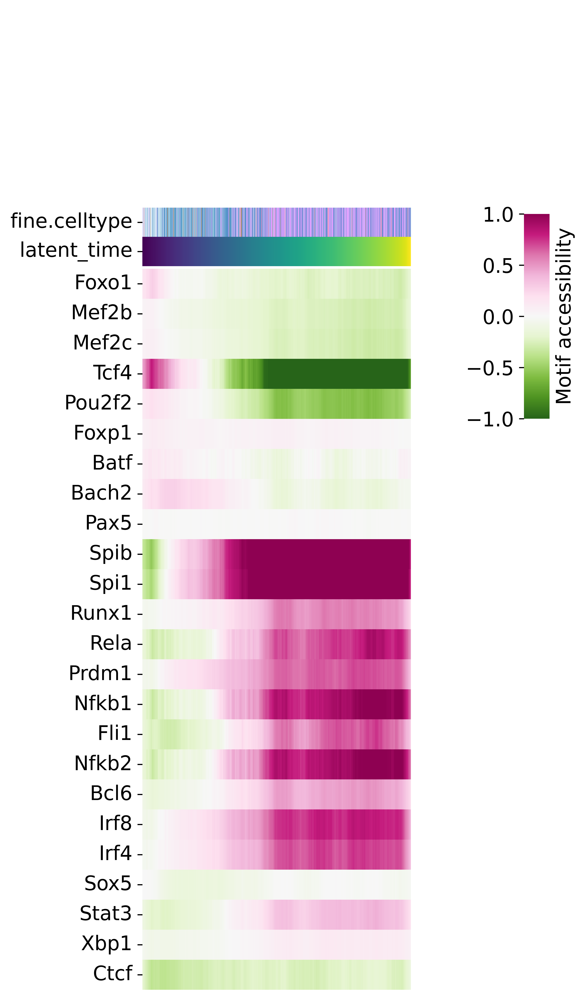

In [22]:
data = adata_atac_pred_CtcfHet_PM[:, tfs_to_plot].to_df()
annotations = adata_atac_pred_CtcfHet_PM.obs[['fine.celltype', 'latent_time']]
annotations['fine.celltype_str'] = annotations['fine.celltype'].astype(str)

celltype_palette = sns.color_palette(adata_atac_pred_CtcfHet_PM.uns['fine.celltype_colors'])
celltype_dict = dict(zip(adata_atac_pred_CtcfHet_PM.obs['fine.celltype'].cat.categories, celltype_palette))
celltype_colors = annotations['fine.celltype_str'].map(celltype_dict)

norm = mcolors.Normalize(vmin=annotations['latent_time'].min(), vmax=annotations['latent_time'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
latent_time_colors = annotations['latent_time'].map(lambda x: mcolors.to_hex(sm.to_rgba(x)))

row_colors = pd.DataFrame({
    'fine.celltype': celltype_colors,
    'latent_time': latent_time_colors
})

annotations_sorted = annotations.sort_values(by=['latent_time'])
data_sorted = data.loc[annotations_sorted.index].transpose()

smooth = True
N_smooth = 200
if smooth:
    data_smooth = data_sorted.values.copy()
    for r in range(data_smooth.shape[0]):
        data_smooth[r] = np.convolve(data_smooth[r], np.ones(N_smooth)/N_smooth, mode='same')
    data_sorted.loc[:] = data_smooth

g = sns.clustermap(
    data_sorted,
    row_cluster=False,
    col_cluster=False,
    col_colors=row_colors,
    cmap='PiYG_r',
    xticklabels=False,
    center=0,
    vmax=1,
    vmin=-1,
    cbar_pos=(0.92, 0.58, 0.05, 0.2),
    figsize=(5, 10),
    rasterized=True
)
g.cax.set_ylabel('Motif accessibility')
g.tick_params(left=True, labelleft=True, right=False, labelright=False, labelrotation=0)
plt.savefig(fig_dir + f'/motif_accessibility_heatmap_sub_CtcfHet_PM.pdf', bbox_inches="tight")

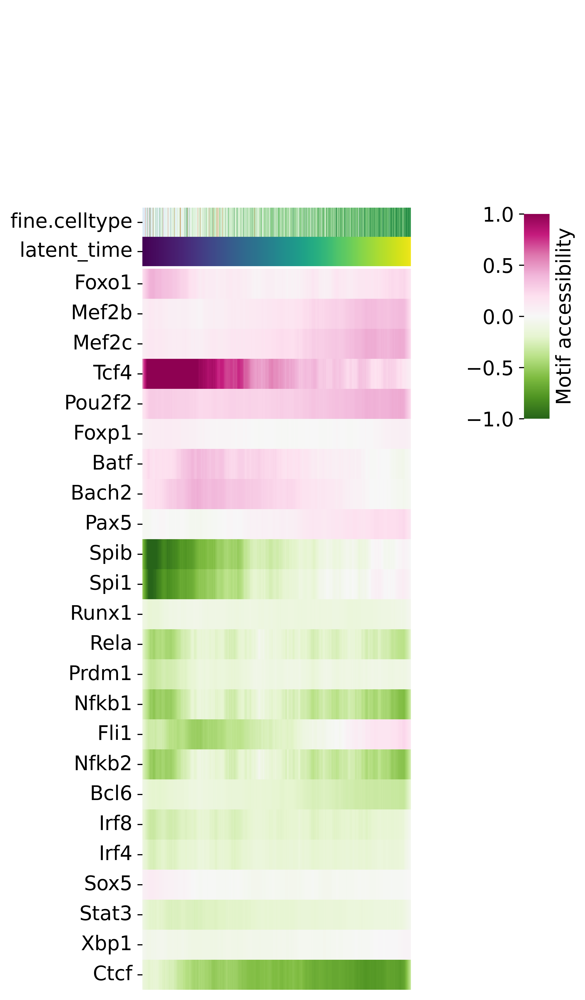

In [23]:
data = adata_atac_pred_CB[:, tfs_to_plot].to_df()
annotations = adata_atac_pred_CB.obs[['fine.celltype', 'latent_time']]
annotations['fine.celltype_str'] = annotations['fine.celltype'].astype(str)

celltype_palette = sns.color_palette(adata_atac_pred_CB.uns['fine.celltype_colors'])
celltype_dict = dict(zip(adata_atac_pred_CB.obs['fine.celltype'].cat.categories, celltype_palette))
celltype_colors = annotations['fine.celltype_str'].map(celltype_dict)

norm = mcolors.Normalize(vmin=annotations['latent_time'].min(), vmax=annotations['latent_time'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
latent_time_colors = annotations['latent_time'].map(lambda x: mcolors.to_hex(sm.to_rgba(x)))

row_colors = pd.DataFrame({
    'fine.celltype': celltype_colors,
    'latent_time': latent_time_colors
})

annotations_sorted = annotations.sort_values(by=['latent_time'])
data_sorted = data.loc[annotations_sorted.index].transpose()

smooth = True
N_smooth = 200
if smooth:
    data_smooth = data_sorted.values.copy()
    for r in range(data_smooth.shape[0]):
        data_smooth[r] = np.convolve(data_smooth[r], np.ones(N_smooth)/N_smooth, mode='same')
    data_sorted.loc[:] = data_smooth

g = sns.clustermap(
    data_sorted,
    row_cluster=False,
    col_cluster=False,
    col_colors=row_colors,
    cmap='PiYG_r',
    xticklabels=False,
    center=0,
    vmax=1,
    vmin=-1,
    cbar_pos=(0.92, 0.58, 0.05, 0.2),
    figsize=(5, 10),
    rasterized=True
)
g.cax.set_ylabel('Motif accessibility')
g.tick_params(left=True, labelleft=True, right=False, labelright=False, labelrotation=0)
plt.savefig(fig_dir + f'/motif_accessibility_heatmap_sub_CtcfWT29_CB.pdf', bbox_inches="tight")

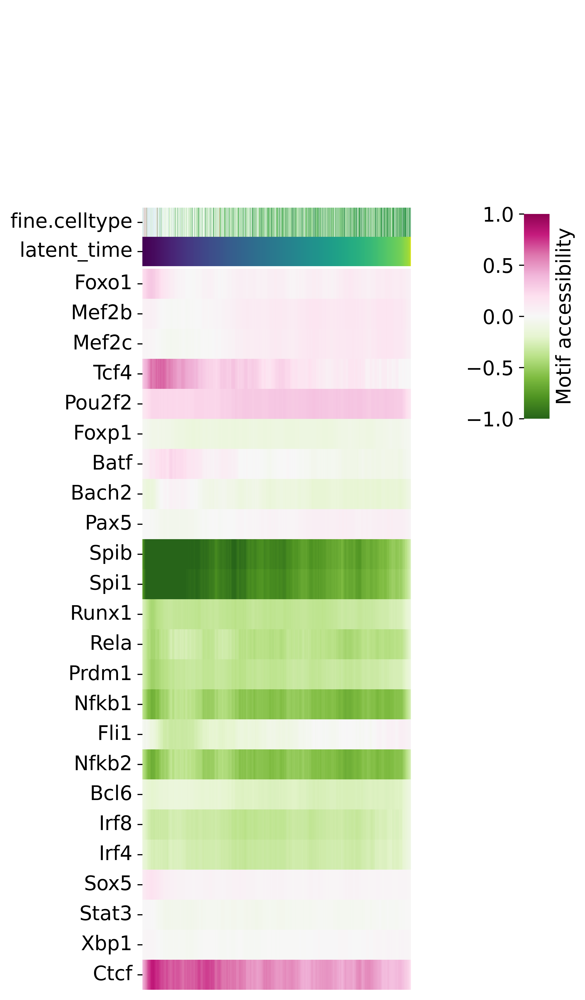

In [24]:
data = adata_atac_pred_Arid1aHet_CB[:, tfs_to_plot].to_df()
annotations = adata_atac_pred_Arid1aHet_CB.obs[['fine.celltype', 'latent_time']]
annotations['fine.celltype_str'] = annotations['fine.celltype'].astype(str)

celltype_palette = sns.color_palette(adata_atac_pred_Arid1aHet_CB.uns['fine.celltype_colors'])
celltype_dict = dict(zip(adata_atac_pred_Arid1aHet_CB.obs['fine.celltype'].cat.categories, celltype_palette))
celltype_colors = annotations['fine.celltype_str'].map(celltype_dict)

norm = mcolors.Normalize(vmin=annotations['latent_time'].min(), vmax=annotations['latent_time'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
latent_time_colors = annotations['latent_time'].map(lambda x: mcolors.to_hex(sm.to_rgba(x)))

row_colors = pd.DataFrame({
    'fine.celltype': celltype_colors,
    'latent_time': latent_time_colors
})

annotations_sorted = annotations.sort_values(by=['latent_time'])
data_sorted = data.loc[annotations_sorted.index].transpose()

smooth = True
N_smooth = 200
if smooth:
    data_smooth = data_sorted.values.copy()
    for r in range(data_smooth.shape[0]):
        data_smooth[r] = np.convolve(data_smooth[r], np.ones(N_smooth)/N_smooth, mode='same')
    data_sorted.loc[:] = data_smooth

g = sns.clustermap(
    data_sorted,
    row_cluster=False,
    col_cluster=False,
    col_colors=row_colors,
    cmap='PiYG_r',
    xticklabels=False,
    center=0,
    vmax=1,
    vmin=-1,
    cbar_pos=(0.92, 0.58, 0.05, 0.2),
    figsize=(5, 10),
    rasterized=True
)
g.cax.set_ylabel('Motif accessibility')
g.tick_params(left=True, labelleft=True, right=False, labelright=False, labelrotation=0)
plt.savefig(fig_dir + f'/motif_accessibility_heatmap_sub_Arid1aHet_CB.pdf', bbox_inches="tight")

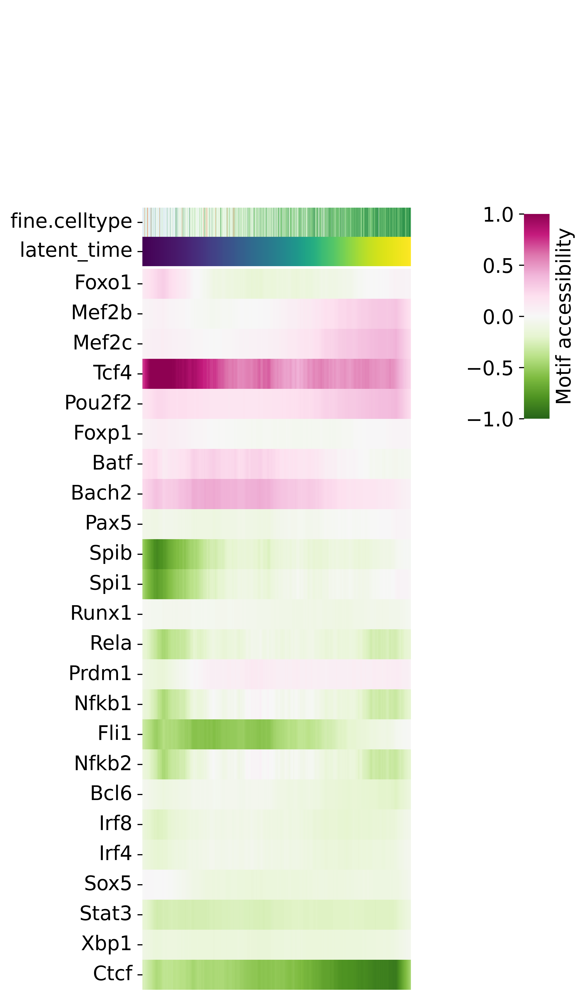

In [25]:
data = adata_atac_pred_CtcfHet_CB[:, tfs_to_plot].to_df()
annotations = adata_atac_pred_CtcfHet_CB.obs[['fine.celltype', 'latent_time']]
annotations['fine.celltype_str'] = annotations['fine.celltype'].astype(str)

celltype_palette = sns.color_palette(adata_atac_pred_CtcfHet_CB.uns['fine.celltype_colors'])
celltype_dict = dict(zip(adata_atac_pred_CtcfHet_CB.obs['fine.celltype'].cat.categories, celltype_palette))
celltype_colors = annotations['fine.celltype_str'].map(celltype_dict)

norm = mcolors.Normalize(vmin=annotations['latent_time'].min(), vmax=annotations['latent_time'].max())
sm = plt.cm.ScalarMappable(cmap='viridis', norm=norm)
sm.set_array([])
latent_time_colors = annotations['latent_time'].map(lambda x: mcolors.to_hex(sm.to_rgba(x)))

row_colors = pd.DataFrame({
    'fine.celltype': celltype_colors,
    'latent_time': latent_time_colors
})

annotations_sorted = annotations.sort_values(by=['latent_time'])
data_sorted = data.loc[annotations_sorted.index].transpose()

smooth = True
N_smooth = 200
if smooth:
    data_smooth = data_sorted.values.copy()
    for r in range(data_smooth.shape[0]):
        data_smooth[r] = np.convolve(data_smooth[r], np.ones(N_smooth)/N_smooth, mode='same')
    data_sorted.loc[:] = data_smooth

g = sns.clustermap(
    data_sorted,
    row_cluster=False,
    col_cluster=False,
    col_colors=row_colors,
    cmap='PiYG_r',
    xticklabels=False,
    center=0,
    vmax=1,
    vmin=-1,
    cbar_pos=(0.92, 0.58, 0.05, 0.2),
    figsize=(5, 10),
    rasterized=True
)
g.cax.set_ylabel('Motif accessibility')
g.tick_params(left=True, labelleft=True, right=False, labelright=False, labelrotation=0)
plt.savefig(fig_dir + f'/motif_accessibility_heatmap_sub_CtcfHet_CB.pdf', bbox_inches="tight")

#### Fig. 3D

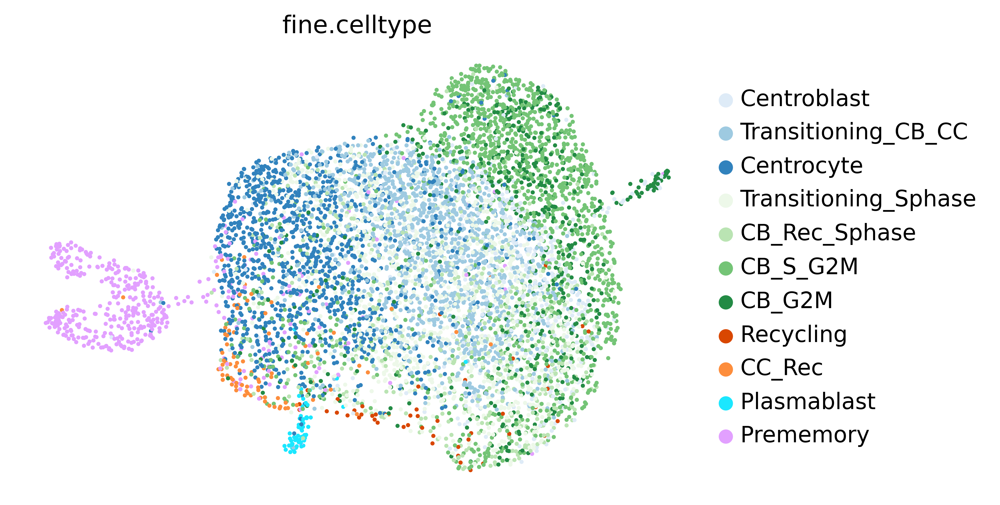

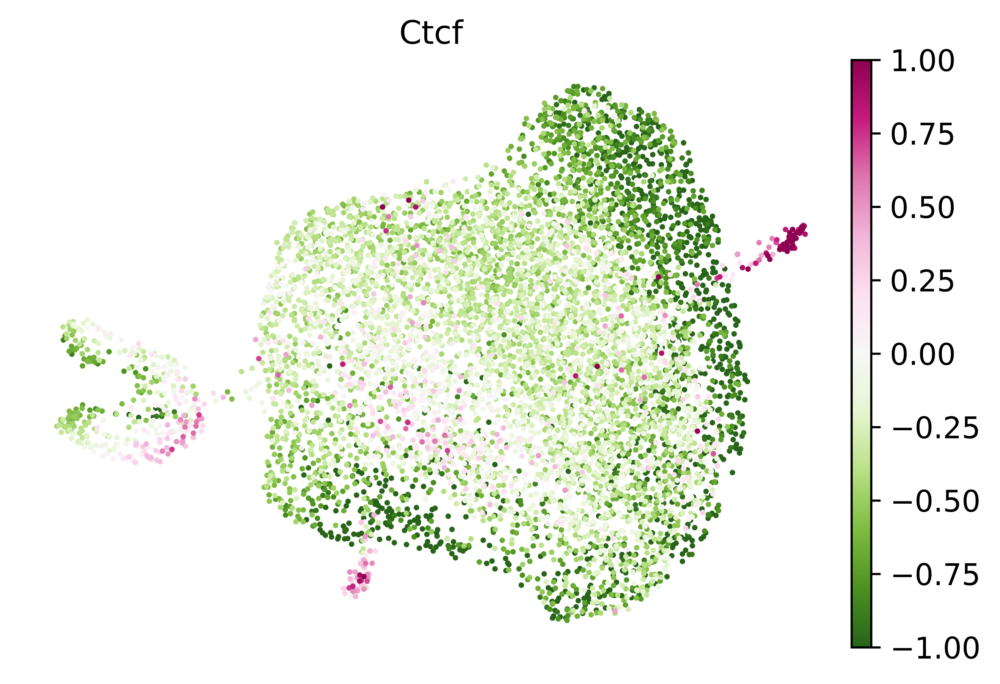

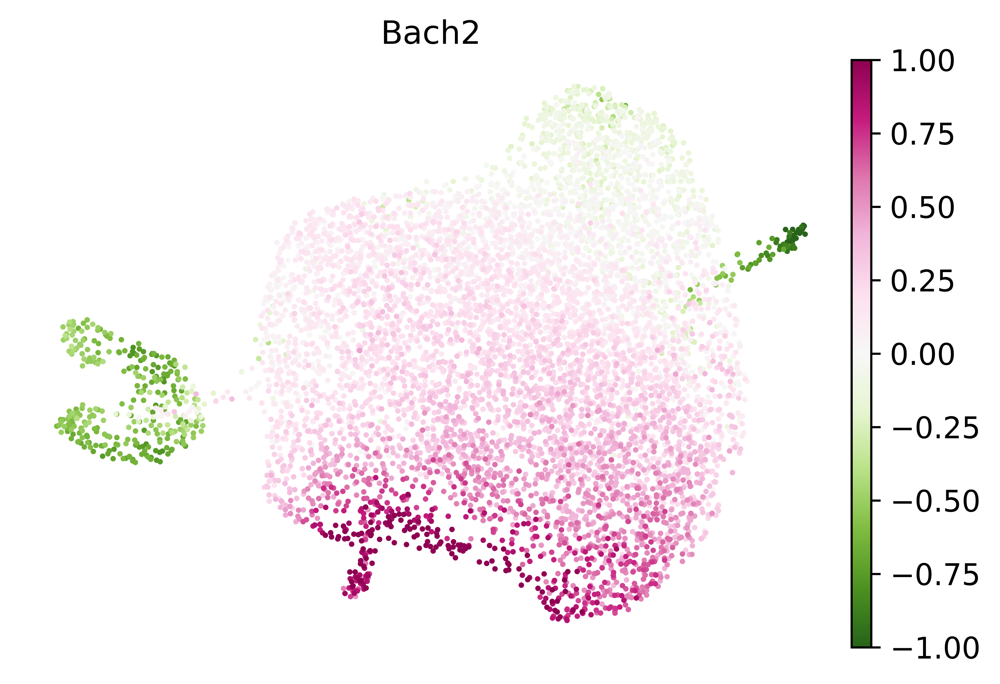

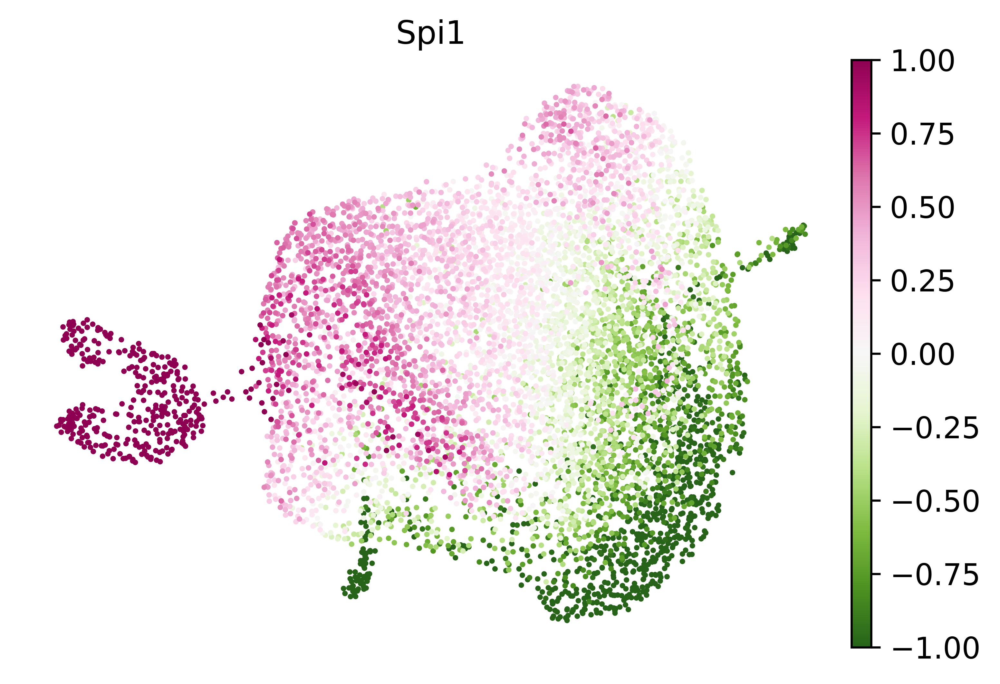

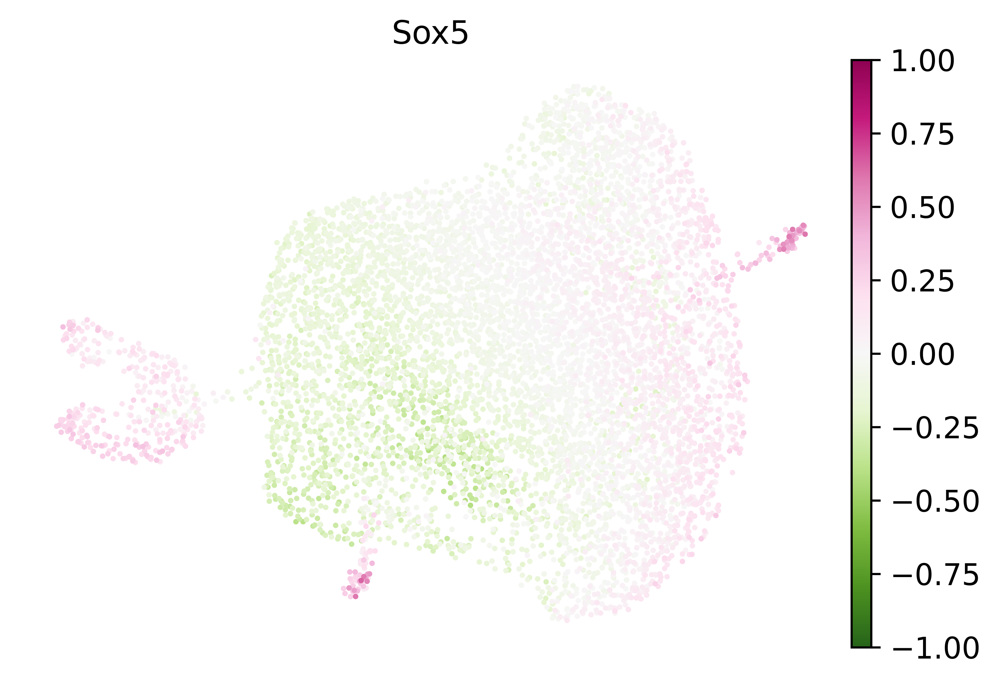

In [27]:

scv.set_figure_params(vector_friendly=True, dpi_save=300, dpi=300)

sc.pp.neighbors(adata_atac_pred, n_neighbors=50, use_rep='X')
sc.tl.umap(adata_atac_pred, min_dist=1, spread=1, random_state=0, n_components=2)
sc.pl.umap(adata_atac_pred, color='fine.celltype', show=False, frameon=False)

for tf in ['Ctcf', 'Bach2', 'Spi1', 'Sox5']:
    sc.pl.umap(adata_atac_pred, color=tf, vcenter=0, vmax=1, vmin=-1, cmap='PiYG_r', show=False, frameon=False)
    plt.show()
    plt.savefig(fig_dir+f'/umap_motif_{tf}.pdf', bbox_inches="tight")
    plt.close()

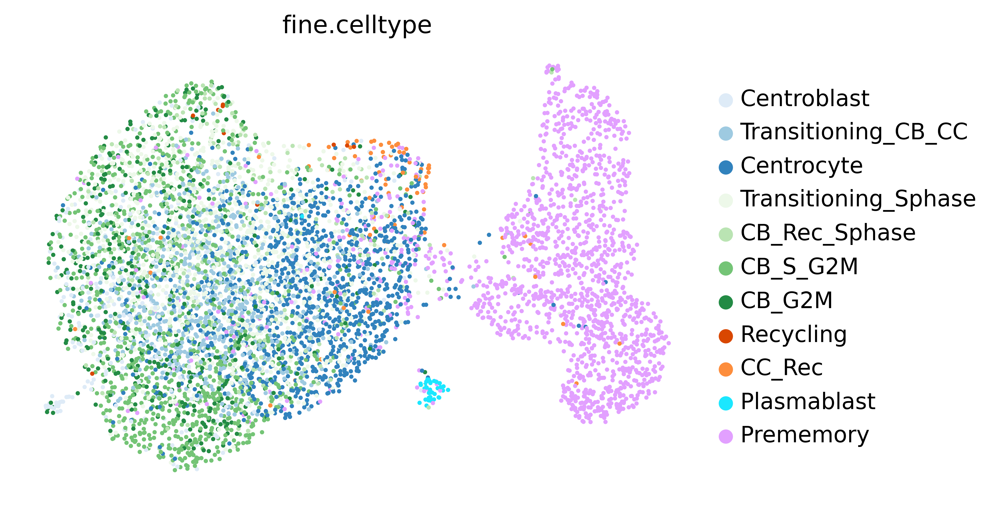

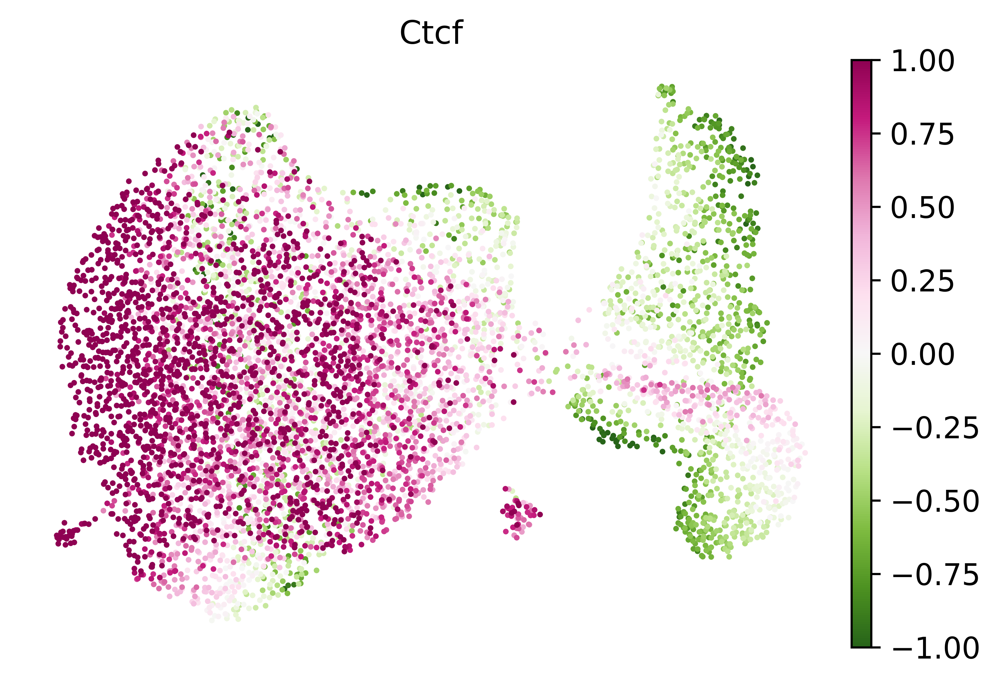

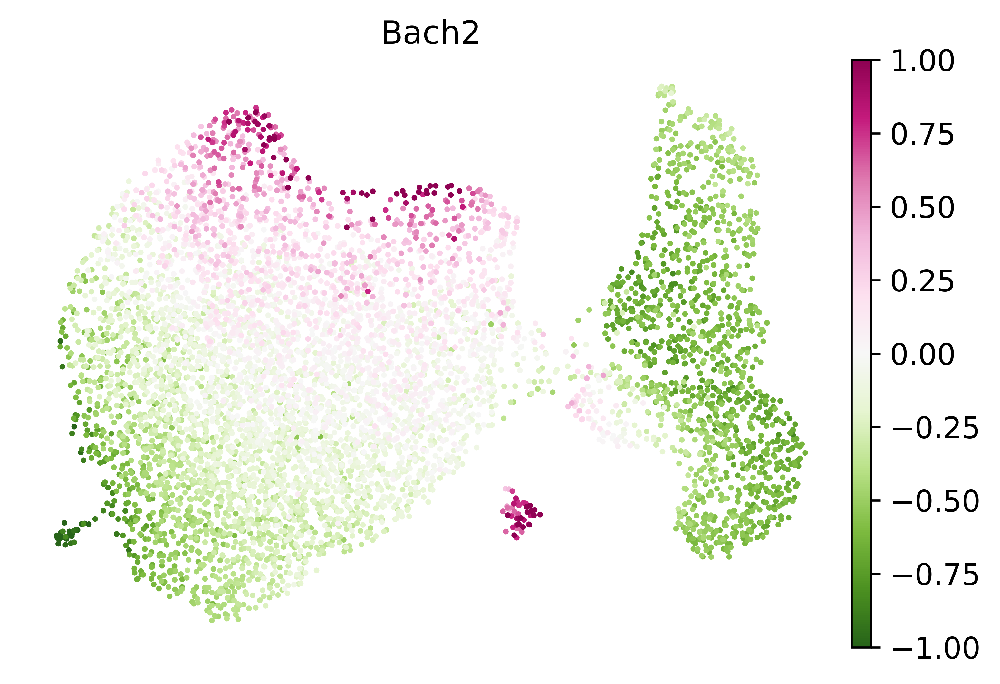

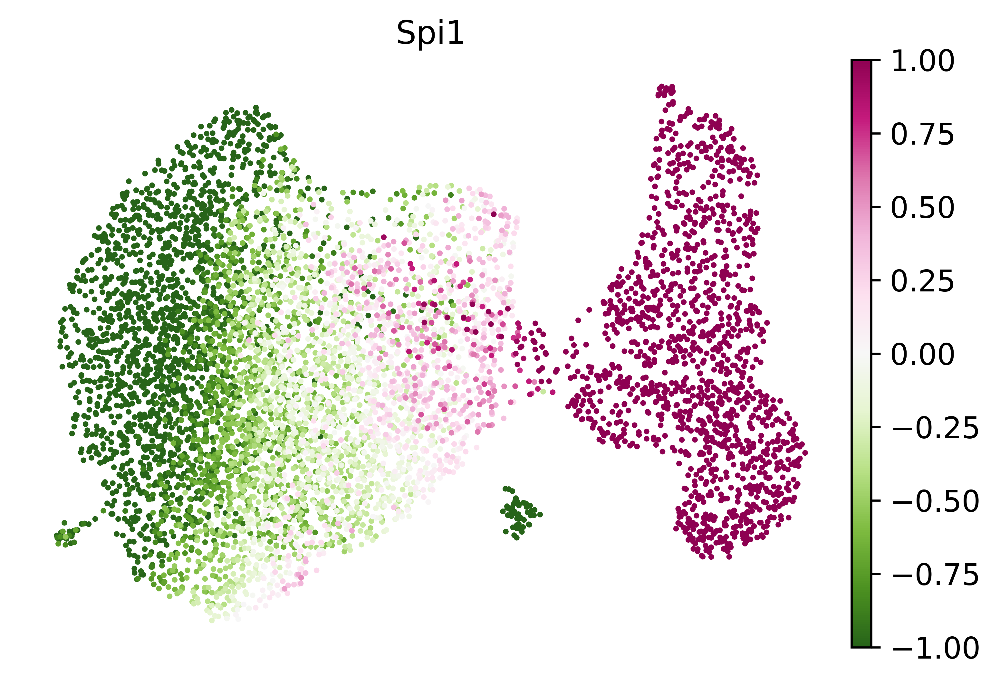

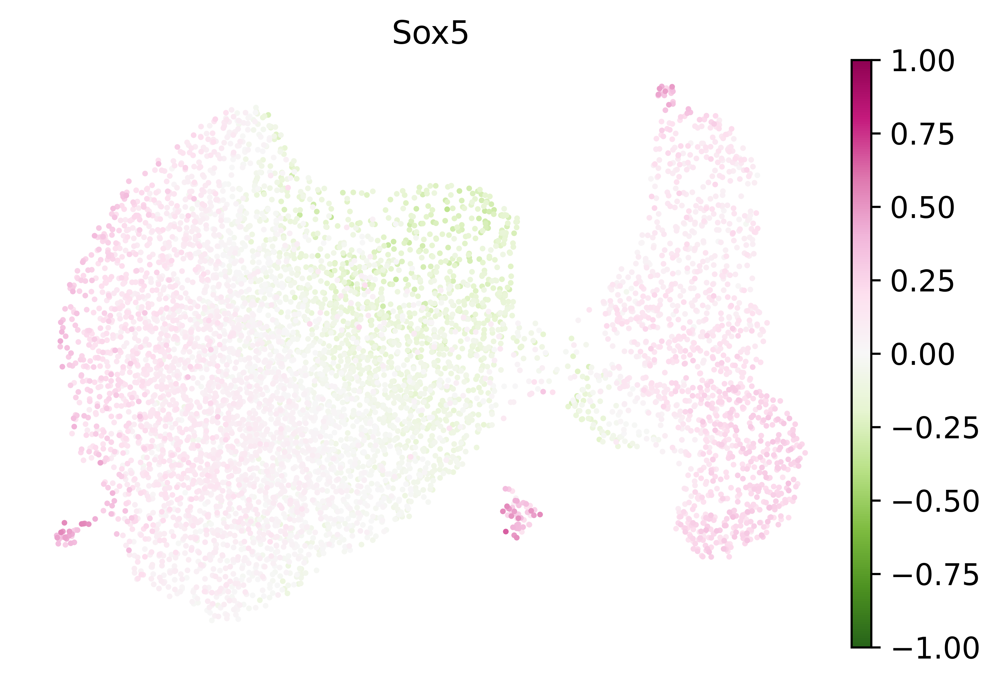

In [28]:
sc.pp.neighbors(adata_atac_pred_Arid1aHet, n_neighbors=50, use_rep='X')
sc.tl.umap(adata_atac_pred_Arid1aHet, min_dist=1, spread=1, random_state=0, n_components=2)
sc.pl.umap(adata_atac_pred_Arid1aHet, color='fine.celltype', show=False, frameon=False)

for tf in ['Ctcf', 'Bach2', 'Spi1', 'Sox5']:
    sc.pl.umap(adata_atac_pred_Arid1aHet, color=tf, vcenter=0, vmax=1, vmin=-1, cmap='PiYG_r', show=False, frameon=False)
    plt.show()
    plt.savefig(fig_dir+f'/umap_motif_Arid1aHet_{tf}.pdf', bbox_inches="tight")
    plt.close()

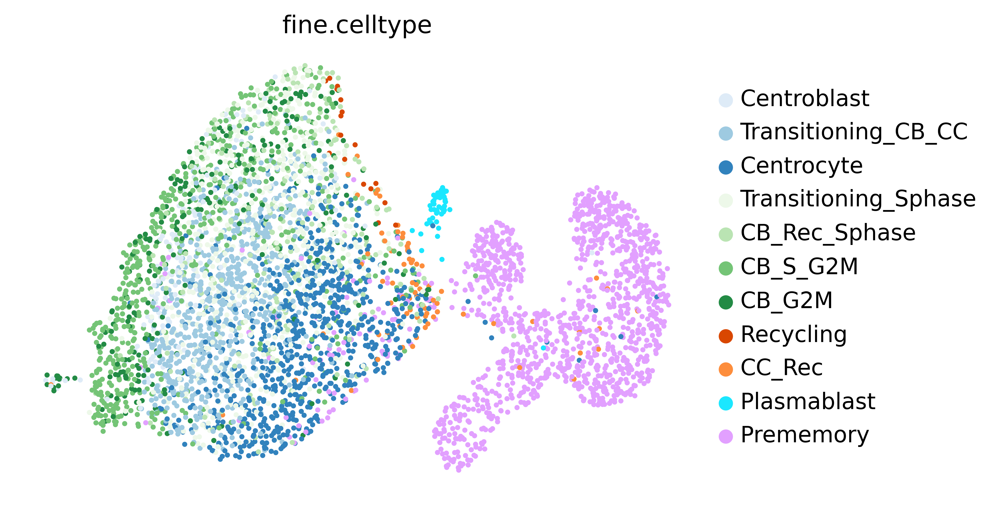

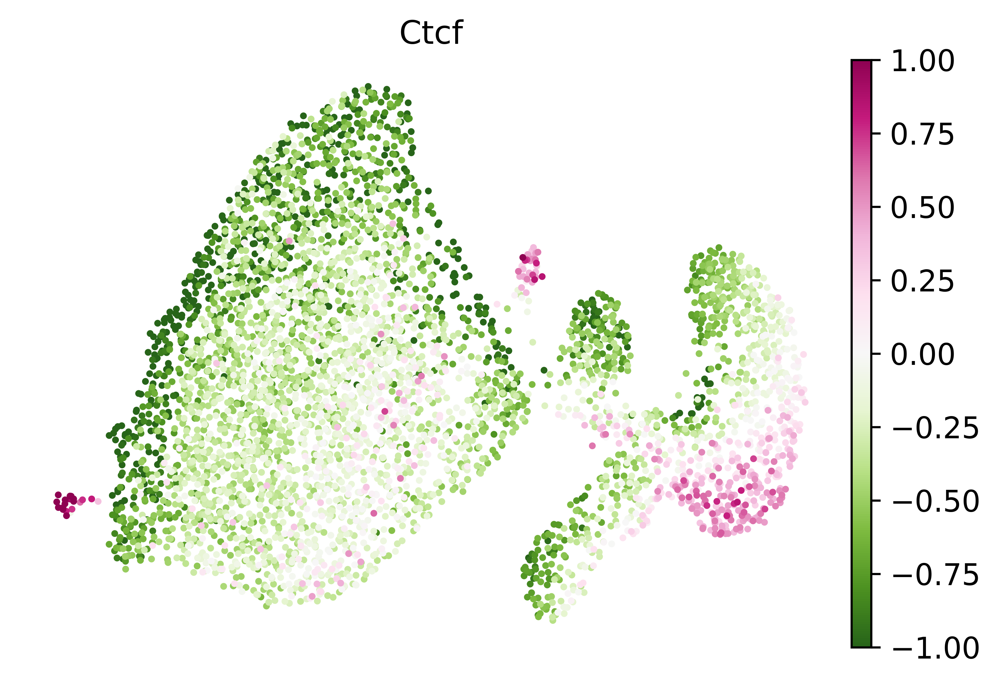

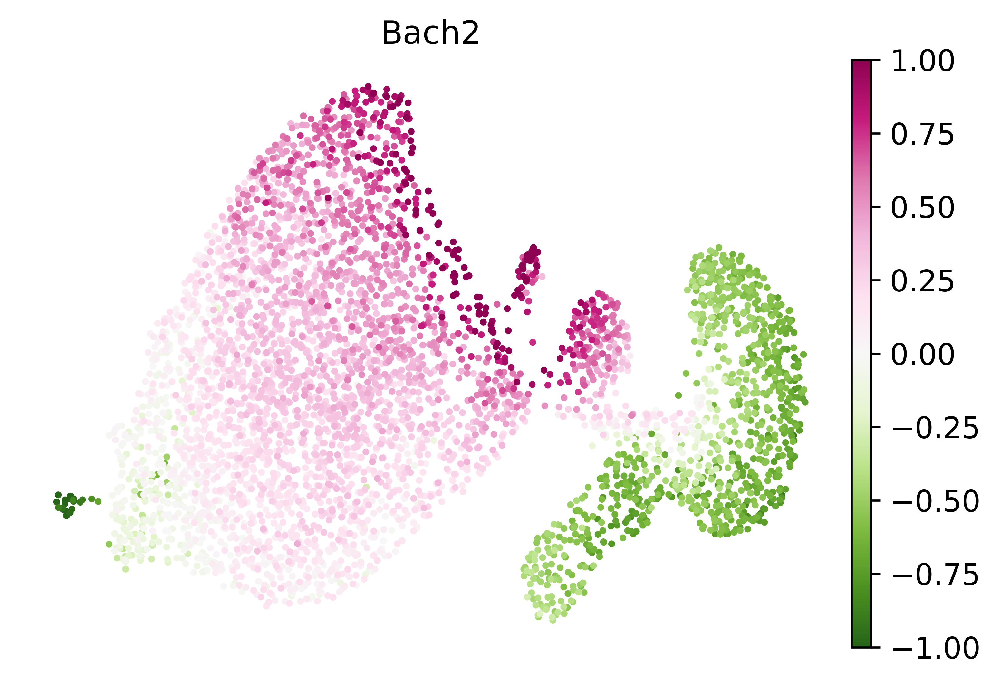

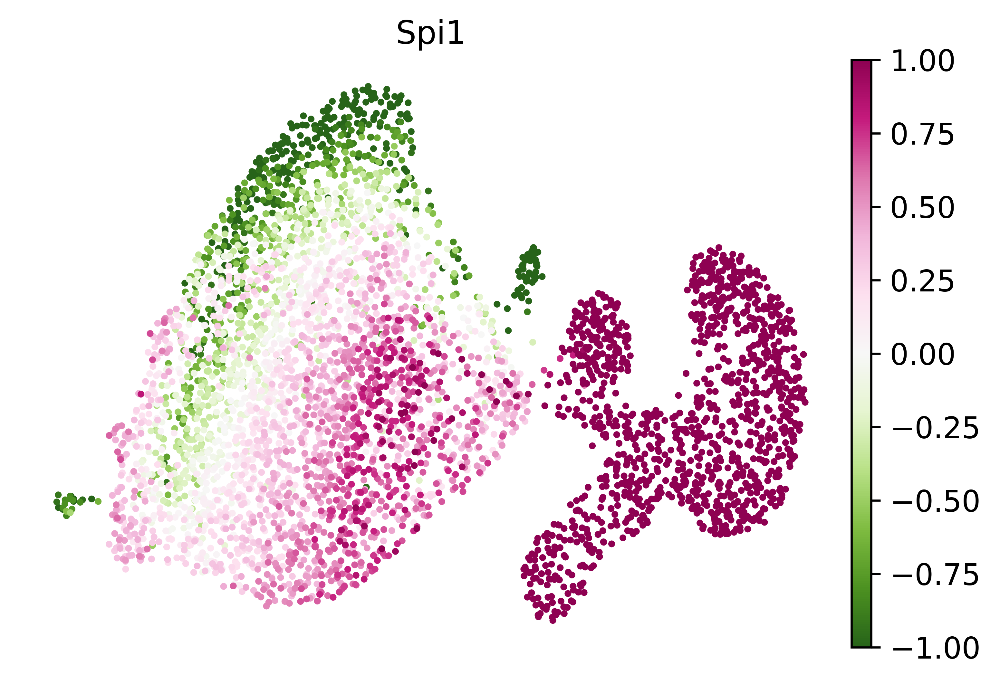

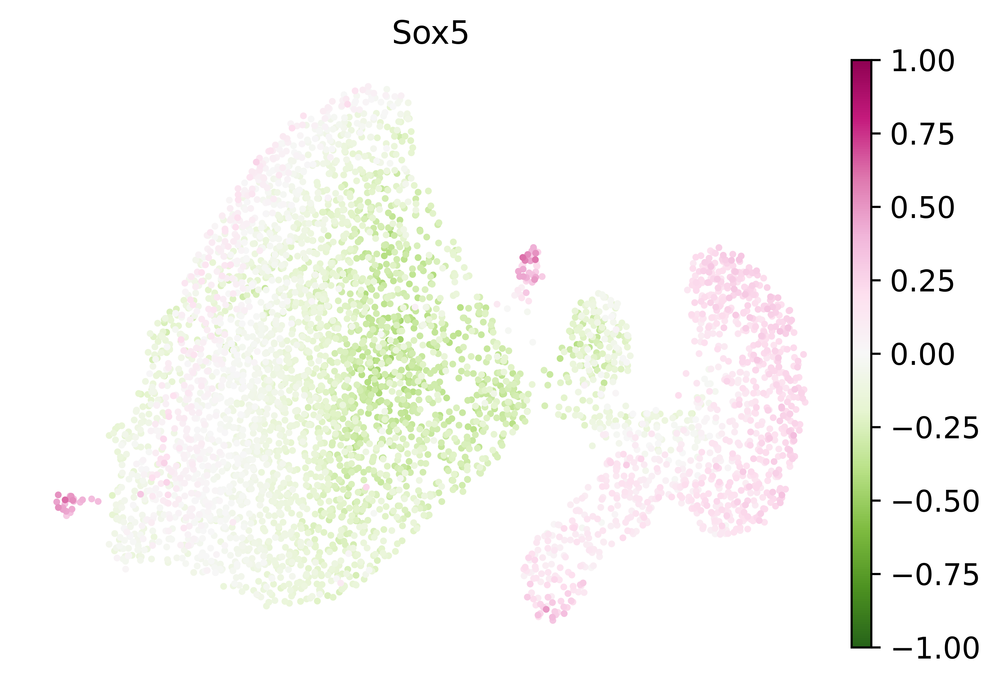

In [29]:
sc.pp.neighbors(adata_atac_pred_CtcfHet, n_neighbors=50, use_rep='X')
sc.tl.umap(adata_atac_pred_CtcfHet, min_dist=1, spread=1, random_state=0, n_components=2)
sc.pl.umap(adata_atac_pred_CtcfHet, color='fine.celltype', show=False, frameon=False)

for tf in ['Ctcf', 'Bach2', 'Spi1', 'Sox5']:
    sc.pl.umap(adata_atac_pred_CtcfHet, color=tf, vcenter=0, vmax=1, vmin=-1, cmap='PiYG_r', show=False, frameon=False)
    plt.show()
    plt.savefig(fig_dir+f'/umap_motif_CtcfHet_{tf}.pdf', bbox_inches="tight")
    plt.close()